In [1]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.semi_supervised import LabelPropagation
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import silhouette_score, davies_bouldin_score
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [23]:
df = pd.read_csv("../data/data_sensors.csv")

In [24]:
df

,Sensor 0,Sensor 1,Sensor 2,Sensor 3,Sensor 4,Sensor 5,Sensor 6,Sensor 7,Sensor 8,Sensor 9,...,Sensor 11,Sensor 12,Sensor 13,Sensor 14,Sensor 15,Sensor 16,Sensor 17,Sensor 18,Sensor 19,Label
0,-0.545785,-0.639964,0.323172,0.870056,0.589634,-0.654516,0.758626,-0.944226,-0.361981,-0.738958,...,0.367026,-0.684776,-0.442127,-0.797051,-0.849937,0.109651,0.275428,0.724551,-0.957438,NaN
1,0.291232,-0.188508,-0.266294,-0.931173,0.990036,-0.782436,-0.356253,0.777890,0.864639,0.510940,...,-0.144257,-0.403463,-0.029867,-0.876624,0.976521,0.983823,-0.095941,0.987311,0.245192,NaN
2,0.680580,0.423410,0.734204,-0.023014,0.639396,-0.495548,-0.373933,-0.842535,-0.228202,-0.330048,...,-0.675210,0.634603,-0.317718,-0.362630,-0.658235,0.290307,-0.560638,-0.477552,-0.206955,NaN
3,0.055538,0.116893,0.421156,0.154056,-0.107440,-0.618401,-0.915526,0.967082,-0.205136,0.591844,...,-0.373325,-0.306537,0.161707,-0.757658,-0.838197,-0.658364,0.210658,0.204989,0.663093,NaN
4,0.521701,0.066350,0.285818,0.083620,0.166119,0.387446,0.205991,-0.266857,-0.288621,0.542669,...,-0.176694,0.727822,0.274874,-0.412379,-0.657580,0.726756,0.283499,0.579462,-0.524631,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1595,-0.857514,-0.901746,0.682112,0.669216,0.389174,0.353169,0.209446,-0.622330,0.917440,0.441477,...,0.899953,-0.276729,0.417999,-0.921676,-0.208828,0.354655,0.834750,-0.387406,0.743095,NaN
1596,-0.644620,0.120782,-0.428661,-0.897351,0.605797,-0.722718,-0.180190,0.626390,-0.540210,0.435336,...,-0.421129,0.977297,-0.675462,-0.854592,0.451110,0.583748,0.575976,0.102684,0.880652,NaN
1597,0.104731,0.371608,-0.396367,0.535360,-0.787202,-0.072538,-0.570076,0.479355,0.692626,-0.113177,...,0.936989,0.347102,-0.694905,0.646308,0.726538,0.649007,-0.442554,0.150262,0.068094,3.0
1598,0.736973,0.840015,0.087787,0.377609,-0.017149,-0.679871,-0.815606,0.943190,-0.736687,-0.465492,...,0.068820,0.092866,-0.795169,0.880328,0.513578,-0.085567,-0.411121,0.773536,-0.336862,NaN


In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1600 entries, 0 to 1599
Data columns (total 21 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Sensor 0   1600 non-null   float64
 1   Sensor 1   1600 non-null   float64
 2   Sensor 2   1600 non-null   float64
 3   Sensor 3   1600 non-null   float64
 4   Sensor 4   1600 non-null   float64
 5   Sensor 5   1600 non-null   float64
 6   Sensor 6   1600 non-null   float64
 7   Sensor 7   1600 non-null   float64
 8   Sensor 8   1600 non-null   float64
 9   Sensor 9   1600 non-null   float64
 10  Sensor 10  1600 non-null   float64
 11  Sensor 11  1600 non-null   float64
 12  Sensor 12  1600 non-null   float64
 13  Sensor 13  1600 non-null   float64
 14  Sensor 14  1600 non-null   float64
 15  Sensor 15  1600 non-null   float64
 16  Sensor 16  1600 non-null   float64
 17  Sensor 17  1600 non-null   float64
 18  Sensor 18  1600 non-null   float64
 19  Sensor 19  1600 non-null   float64
 20  Label   

In [26]:
df['Label'].value_counts()

Label
3.0    20
2.0    10
1.0    10
Name: count, dtype: int64

In [27]:
df.describe()

,Sensor 0,Sensor 1,Sensor 2,Sensor 3,Sensor 4,Sensor 5,Sensor 6,Sensor 7,Sensor 8,Sensor 9,...,Sensor 11,Sensor 12,Sensor 13,Sensor 14,Sensor 15,Sensor 16,Sensor 17,Sensor 18,Sensor 19,Label
count,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,...,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,40.000000
mean,-0.003901,0.010692,0.003611,0.016913,0.006504,-0.035332,0.002607,-0.023096,0.014207,0.001201,...,-0.000107,0.006054,-0.003777,0.003583,0.009220,0.026797,0.018740,0.018144,0.010668,2.250000
std,0.578326,0.580784,0.359632,0.583571,0.570841,0.593607,0.572523,0.588614,0.579928,0.602691,...,0.584802,0.577892,0.359788,0.584293,0.582116,0.569598,0.578555,0.583309,0.576219,0.839719
min,-0.998098,-0.992518,-0.800000,-0.999775,-0.999870,-0.999669,-0.996949,-0.998761,-0.998044,-0.999523,...,-0.999330,-0.996221,-0.800000,-0.998908,-0.998526,-0.999408,-0.998213,-0.999880,-0.998559,1.000000
25%,-0.507756,-0.488596,-0.259969,-0.504151,-0.485490,-0.576116,-0.493367,-0.531029,-0.473253,-0.559439,...,-0.514553,-0.524190,-0.265276,-0.510638,-0.488482,-0.457106,-0.505591,-0.478406,-0.470953,1.750000
50%,0.004809,0.017735,0.000516,0.051528,0.000811,-0.051875,0.015700,-0.043717,0.004869,0.034202,...,0.009776,0.024858,-0.005893,0.031814,0.006501,0.038331,0.009060,0.032383,0.020862,2.500000
75%,0.476584,0.513715,0.270990,0.512762,0.495880,0.481036,0.484419,0.490271,0.503751,0.547635,...,0.516638,0.503594,0.259134,0.522166,0.530700,0.513615,0.537619,0.543224,0.510085,3.000000
max,0.999610,0.999463,0.800000,0.999733,0.992920,0.996972,0.999369,0.999376,0.999143,0.999618,...,0.995784,0.998642,0.800000,0.998700,0.997060,0.995780,0.999772,0.999192,0.999967,3.000000


In [28]:
from ydata_profiling import ProfileReport

profile = ProfileReport(df, title='Dataset Profiling Report', explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [29]:
profile.to_file("profiling_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

For more details on how ydata_profiling handles correlations between different data types, refer to their [General Settings documentation](https://docs.profiling.ydata.ai/4.5/advanced_settings/available_settings/#correlations).

From the profiling report,

- Sensor 9 is highly correlated with Label.

- Sensor 2, 13 are in the range of [-0.8, 0.8]. From the distrubution plot, it seems like the data is clipped. 

- All the other sensors are in the range of [-1, 1].


## Data Preprocessing

In [30]:
# Separate features and labels
sensor_features = df.drop(columns=['Label'])
labels = df['Label']

# Normalize the sensor features
scaler = MinMaxScaler()
sensor_features_scaled = scaler.fit_transform(sensor_features)

## Initial Clustering
Use KMeans to get a basic understanding of the data structure. Here, use the number of unique labels in the labeled data to initialize the cluster count.

In [31]:
# Set the number of clusters based on the unique labels
num_clusters = labels.nunique(dropna=True)

# Perform KMeans clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans_labels = kmeans.fit_predict(sensor_features_scaled)

# Evaluate clustering quality
silhouette_avg = silhouette_score(sensor_features_scaled, kmeans_labels)
print(f'Silhouette Score for KMeans Clustering: {silhouette_avg:.2f}')

# Calculate Davies-Bouldin Index
davies_bouldin = davies_bouldin_score(sensor_features_scaled, kmeans_labels)
print(f'Davies-Bouldin Index for KMeans Clustering: {davies_bouldin:.2f}')


Silhouette Score for KMeans Clustering: 0.04
Davies-Bouldin Index for KMeans Clustering: 4.09


## Algorithm 1: Semi-Supervised Learning with Label Propagation

In scikit-learn, the LabelPropagation class implements the label propagation algorithm, a semi-supervised learning technique that spreads label information from a small set of labeled data points to a larger set of unlabeled data points based on their similarities.

**Implementation Details:**

1. **Graph Construction:** The algorithm constructs a similarity graph where each data point is a node, and edges between nodes represent the similarity between them.
2. **Label Propagation Process:** Labels are iteratively propagated through the graph. In each iteration, a node updates its label distribution based on the labels of its neighbors, weighted by the edge similarities. This process continues until convergence, where labels stabilize.

**Similarity Methods:**

The LabelPropagation class in scikit-learn offers two built-in methods to compute similarities between nodes:

1. RBF (Radial Basis Function) Kernel:
- Description: Also known as the Gaussian kernel, it computes similarity based on the Euclidean distance between data points.
- Formula: $$\text{similarity}(x_i, x_j) = \exp\left(-\gamma \|x_i - x_j\|^2\right) $$
- Parameter: The parameter gamma controls the width of the Gaussian function. A smaller gamma value implies a wider Gaussian, leading to a more global view of the data.
- Usage: This kernel results in a fully connected graph, which can be memory-intensive for large datasets.
2. K-Nearest Neighbors (KNN) Kernel:
- Description: This method connects each data point to its k nearest neighbors, creating a sparse graph.
- Parameter: The parameter n_neighbors specifies the number of neighbors to connect each point to.
- Usage: The KNN kernel produces a sparse similarity matrix, which is more memory-efficient and can lead to faster computations, especially beneficial for large datasets.

**Choosing the Similarity Method:**	

- RBF Kernel: Suitable for smaller datasets where a fully connected graph is computationally feasible. It captures global relationships but may be prone to noise.
- KNN Kernel: Preferred for larger datasets due to its sparsity, which reduces memory usage and computational cost. It focuses on local relationships, making it more robust to noise.

**Implementation in scikit-learn:**

You can specify the kernel method and its parameters when initializing the LabelPropagation model:

```python
from sklearn.semi_supervised import LabelPropagation

# Using RBF kernel
label_prop_rbf = LabelPropagation(kernel='rbf', gamma=20)

# Using KNN kernel
label_prop_knn = LabelPropagation(kernel='knn', n_neighbors=7)
```
For more detailed information, refer to the scikit-learn documentation on [LabelPropagation](https://scikit-learn.org/dev/modules/generated/sklearn.semi_supervised.LabelPropagation.html#).

Default parameters: 
```python
LabelPropagation(kernel='rbf', gamma=20, n_neighbors=7, max_iter=1000, tol=1e-3, n_jobs=None)
```

In [32]:
# Prepare data for Label Propagation by filling NaNs in labels with -1 (unlabeled)
semi_supervised_labels = labels.fillna(-1)

# Apply Label Propagation to infer labels
label_prop_rbf = LabelPropagation(kernel='rbf', gamma=20)
label_prop_rbf.fit(sensor_features_scaled, semi_supervised_labels)
propagated_labels_rbf = label_prop_rbf.transduction_

/Users/lisiqi/Library/Caches/pypoetry/virtualenvs/ml6-clustering-sensor-data-B1uc33Pk-py3.12/lib/python3.12/site-packages/sklearn/semi_supervised/_label_propagation.py:322: ConvergenceWarning: max_iter=1000 was reached without convergence.
  warnings.warn(


### Cluster Evaluation: Silhouette Score & Davies-Bouldin Index

In [33]:
# Calculate silhouette score
silhouette_avg_propagated = silhouette_score(sensor_features_scaled, propagated_labels_rbf)
print(f'Silhouette Score for Label Propagation - rbf kernel: {silhouette_avg_propagated:.2f}')

# Calculate Davies-Bouldin Index
davies_bouldin_propagated = davies_bouldin_score(sensor_features_scaled, propagated_labels_rbf)
print(f'Davies-Bouldin Index for Label Propagation - rbf kernel: {davies_bouldin_propagated:.2f}')

Silhouette Score for Label Propagation - rbf kernel: 0.00
Davies-Bouldin Index for Label Propagation - rbf kernel: 9.83


**Silhouette Score**

The silhouette score is a metric used to evaluate the quality of clustering by measuring how similar an object is to its own cluster compared to other clusters. It ranges from -1 to 1, where:

-	+1 indicates that the sample is far away from neighboring clusters, suggesting well-defined clusters.
-	0 indicates that the sample is on or very close to the decision boundary between two neighboring clusters.
-	-1 indicates that the sample might have been assigned to the wrong cluster, as it is closer to a neighboring cluster than to its own.


A silhouette score of 0.04 indicates that the clusters are poorly defined. This low score suggests that the data points are very close to the decision boundary between clusters, implying significant overlap and ambiguity in cluster assignments. In such cases, it may be beneficial to:

- Reevaluate the number of clusters: The current number may not be optimal.
- Consider different clustering algorithms: Some algorithms may better capture the underlying structure of the data.
- Perform feature engineering: Enhancing or selecting more relevant features can improve clustering performance.

A silhouette score of 0.00 indicates that the data points are on or very close to the decision boundary between clusters, suggesting significant overlap and ambiguity in cluster assignments. This implies that the label propagation algorithm may not have effectively distinguished between different clusters in your dataset.

**Davies-Bouldin Index**

The Davies-Bouldin index is a metric used to evaluate the quality of clustering by measuring the average similarity between clusters. It ranges from 0 to infinity, where:

- 0 indicates perfect clustering, with each cluster being distinct and well-separated.
- Higher values indicate poorer clustering, with clusters that are more similar to each other or overlapping.

**Further thoughts:**

- Artificial data is hard to cluster.
- Are there more reasons of breakdowns? (more label values? 3 labels are not enough?)


In [34]:
label_prop_knn = LabelPropagation(kernel='knn', n_neighbors=7)
label_prop_knn.fit(sensor_features_scaled, semi_supervised_labels)
propagated_labels_knn = label_prop_knn.transduction_

# Calculate silhouette score
silhouette_avg_propagated = silhouette_score(sensor_features_scaled, propagated_labels_knn)
print(f'Silhouette Score for Label Propagation - knn kernel: {silhouette_avg_propagated:.2f}')

# Calculate Davies-Bouldin Index
davies_bouldin_propagated = davies_bouldin_score(sensor_features_scaled, propagated_labels_knn)
print(f'Davies-Bouldin Index for Label Propagation - knn kernel: {davies_bouldin_propagated:.2f}')

Silhouette Score for Label Propagation - knn kernel: 0.00
Davies-Bouldin Index for Label Propagation - knn kernel: 8.76


## Post-clustering analysis: Dive into clustered breakdown reasons
To analyze each cluster and identify patterns for each breakdown reason, we can use descriptive statistics, visualizations, and statistical tests to discover unique sensor behaviors or thresholds. 

### Visualize Cluster Patterns

Plot the clusters for insight into patterns across different sensors. We’ll use PCA to reduce dimensions for a 2D scatter plot.

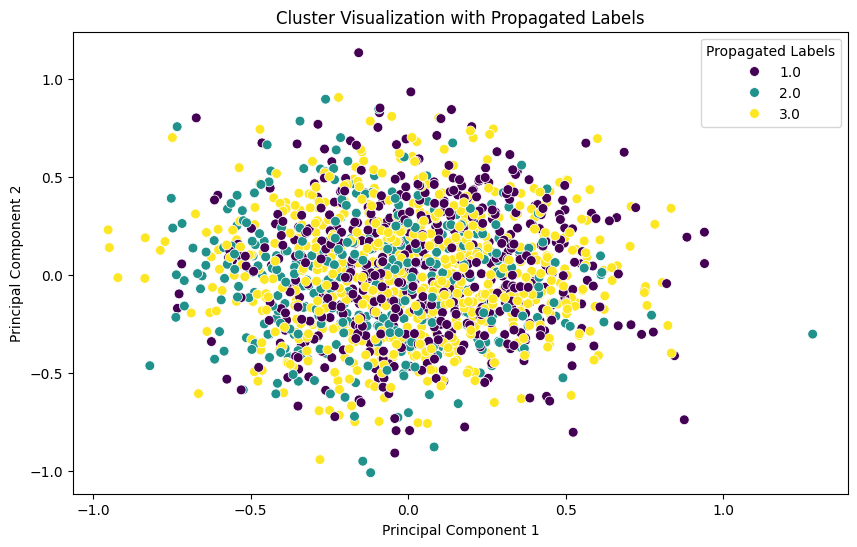

In [35]:
from sklearn.decomposition import PCA

# Reduce to 2 dimensions for visualization
pca = PCA(n_components=2)
sensor_features_pca = pca.fit_transform(sensor_features_scaled)

# Plot clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x=sensor_features_pca[:, 0], y=sensor_features_pca[:, 1],
                hue=propagated_labels_rbf, palette='viridis', s=50)
plt.title('Cluster Visualization with Propagated Labels')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Propagated Labels')

### Summary Statistics by Cluster

Calculate summary statistics to identify unique behaviors for each breakdown reason.

In [36]:
df['propagated_labels_rbf'] = propagated_labels_rbf


In [42]:
# Summary statistics for each sensor within each cluster
summary_stats = df.drop(columns=['Label']).groupby('propagated_labels_rbf').describe().T
summary_stats

propagated_labels_rbf         1.0         2.0         3.0
Sensor 0  count        554.000000  374.000000  672.000000
          mean          -0.049249    0.195865   -0.077696
          std            0.544031    0.592501    0.573201
          min           -0.998098   -0.995167   -0.997503
          25%           -0.504067   -0.298105   -0.575176
...                           ...         ...         ...
Sensor 19 min           -0.997625   -0.996740   -0.998559
          25%           -0.443030   -0.520405   -0.468296
          50%            0.173945   -0.114569   -0.004646
          75%            0.606382    0.403933    0.474784
          max            0.999967    0.971938    0.990704

[160 rows x 3 columns]

### Visualize Sensor Distributions by Cluster

Using box plots or density plots to visualize sensor distributions for each cluster can help identify unique patterns.

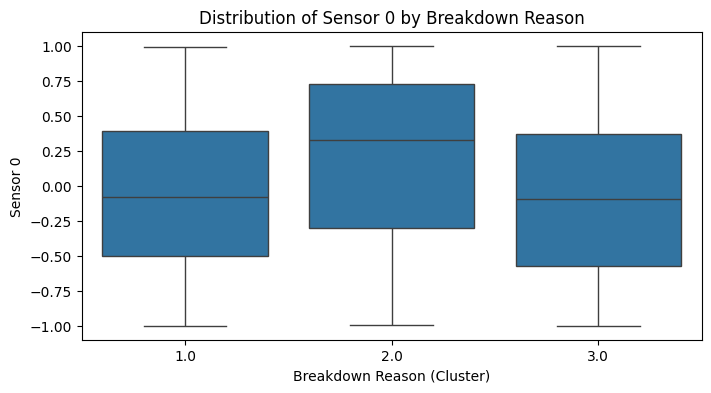

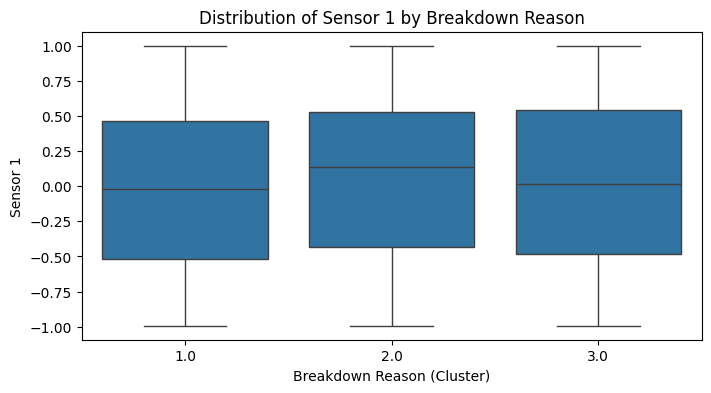

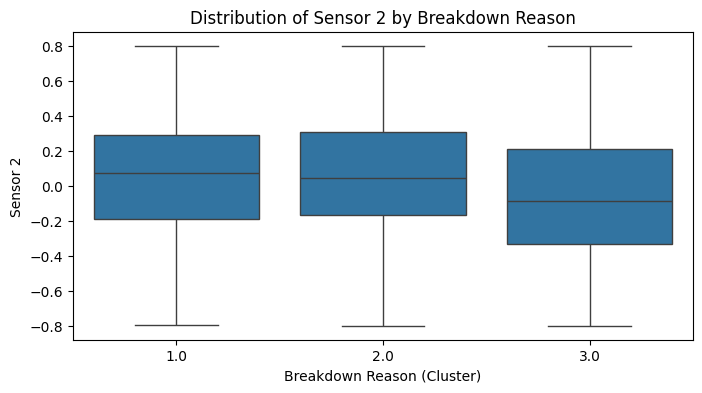

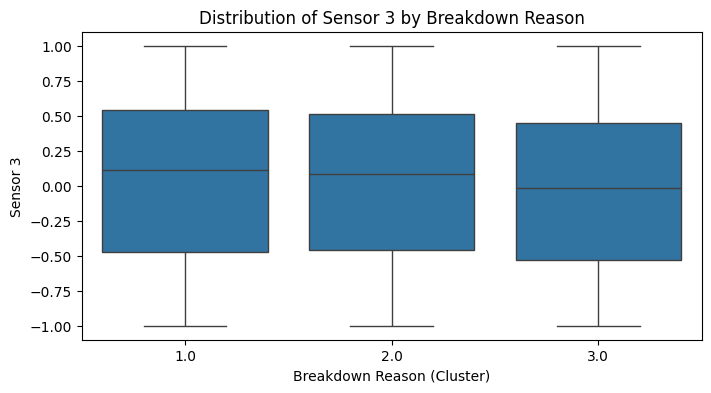

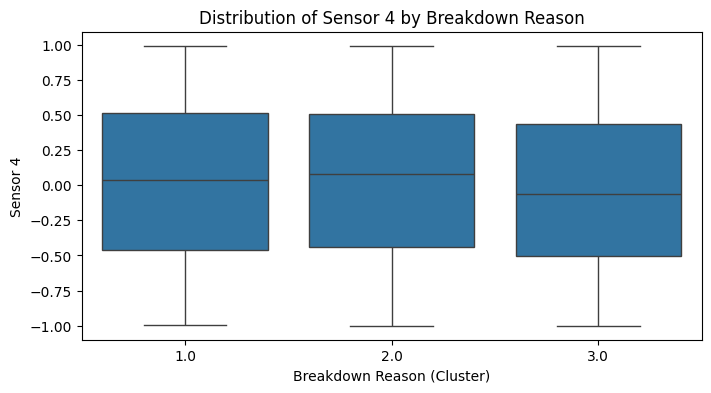

...

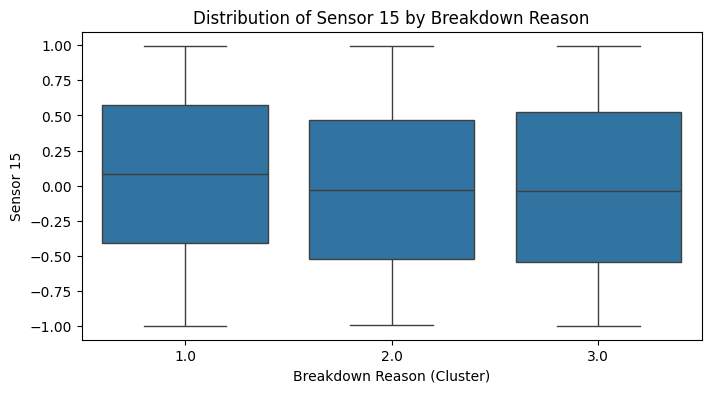

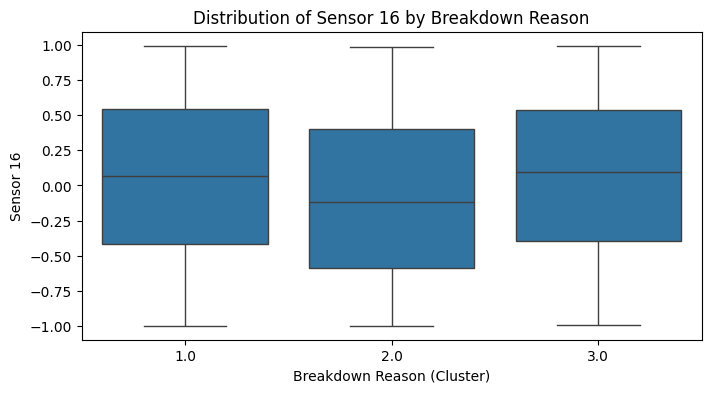

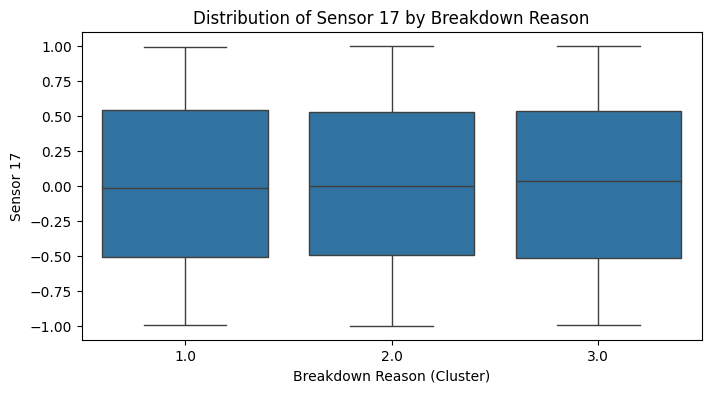

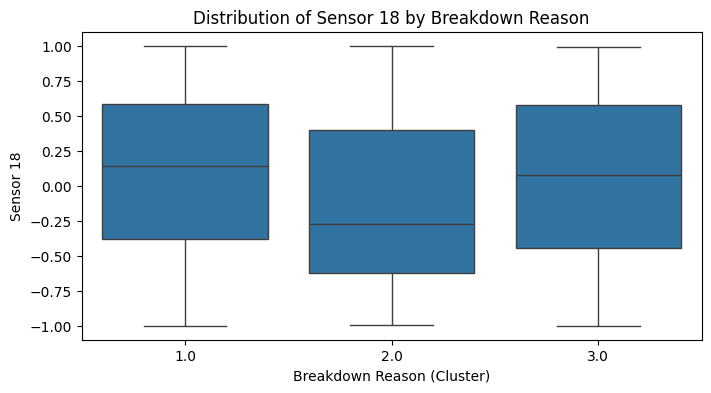

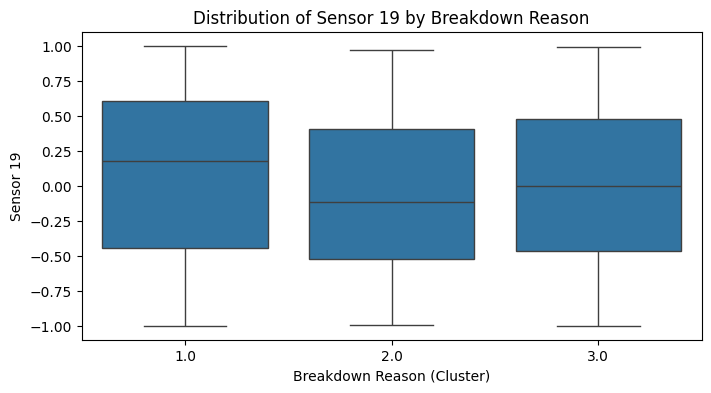

In [43]:
# Boxplot for sensor distribution by cluster (propagated_labels)
for sensor in sensor_features.columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x='propagated_labels_rbf', y=sensor, data=df)
    plt.title(f'Distribution of {sensor} by Breakdown Reason')
    plt.xlabel('Breakdown Reason (Cluster)')
    plt.ylabel(sensor)
    plt.show()

## Algorithm 2: Nearest Centroid


My own intuitive algorithm:

- use the labeled data to get the centroids.
- for each unlabeled point, calculate the distance to all the centroids.
- assign the unlabeled point to the nearest centroid.

The implementation in sklearn is the `Nearest Centroid`. This difference between K-means and Nearest Centroid is that the centriods of Nearest Centroild are static, calculated from the labeled data, whereas in K-means the centroids are iteratively updated.


In [16]:
df = pd.read_csv("../data/data_sensors.csv")

In [17]:
df_labeled = df[~df['Label'].isna()]
df_unlabeled = df[df['Label'].isna()]


In [18]:
X_labeled = df_labeled.drop(columns=['Label'])
y_labeled = df_labeled['Label']
X_unlabeled = df_unlabeled.drop(columns=['Label'])

In [19]:
from sklearn.neighbors import NearestCentroid

# Initialize the classifier
clf = NearestCentroid()

# Fit the model using the labeled data
clf.fit(X_labeled, y_labeled)

# Predict labels for the unlabeled data
y_unlabeled_pred = clf.predict(X_unlabeled)

In [20]:
y_unlabeled_pred

array([3., 3., 2., ..., 1., 2., 2.])

In [21]:
# Predict on the unlabeled data
y_unlabeled_pred = clf.predict(X_unlabeled)

# Silhouette Score
silhouette_avg = silhouette_score(X_unlabeled, y_unlabeled_pred)
print(f'Silhouette Score: {silhouette_avg:.2f}')

# Davies-Bouldin Index
db_index = davies_bouldin_score(X_unlabeled, y_unlabeled_pred)
print(f'Davies-Bouldin Index: {db_index:.2f}')

Silhouette Score: 0.03
Davies-Bouldin Index: 5.01


## Use test set to evaluate the algorithm performance
Set aside a portion of the initially labeled data as test data to evaluate the performance of two algorithms.

We can apply the standard 80-20 train-test split. But since the inital labelded dataset has only 40 data points, we can also apply k-fold cross validation.

I will apply a modified version of k-fold: Apply k-fold on initial labeled dataset, keep one fold as validation set, the other folds and all the unlabeled data as training set.

### Label Propagation with RBF Kernel

In [47]:
from sklearn.model_selection import KFold
from sklearn.preprocessing import MinMaxScaler
from sklearn.semi_supervised import LabelPropagation
from sklearn.metrics import f1_score
import numpy as np


df = pd.read_csv("../data/data_sensors.csv")

# Separate labeled and unlabeled data
labeled_data = df[df['Label'].notna()]
unlabeled_data = df[df['Label'].isna()]

# Features and labels for labeled data
labeled_features = labeled_data.drop(columns=['Label'])
labeled_labels = labeled_data['Label']

# Features for unlabeled data
unlabeled_features = unlabeled_data.drop(columns=['Label'])

# Normalize the sensor features
scaler = MinMaxScaler()
unlabeled_features_scaled = scaler.fit_transform(unlabeled_features)
labeled_features_scaled = scaler.transform(labeled_features)


# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)  # 5-fold CV
f1_scores = []

# Perform k-fold CV on labeled data
for train_index, val_index in kf.split(labeled_features_scaled):
    # Split the labeled data into training and validation sets
    X_train_labeled, X_val = labeled_features_scaled[train_index], labeled_features_scaled[val_index]
    y_train_labeled, y_val = labeled_labels.iloc[train_index], labeled_labels.iloc[val_index]
    
    # Combine labeled training data with unlabeled data for label propagation
    X_train = np.vstack([X_train_labeled, unlabeled_features_scaled])
    y_train = np.concatenate([y_train_labeled, [-1] * len(unlabeled_features_scaled)])  # Mark unlabeled as -1
    
    # Apply Label Propagation
    label_prop_rbf = LabelPropagation(kernel='rbf', gamma=20)
    label_prop_rbf.fit(X_train, y_train)
    
    # Predict labels for the validation set
    y_pred = label_prop_rbf.predict(X_val)
    
    # Compute F1 score for this fold (macro-averaged for multi-class)
    f1 = f1_score(y_val, y_pred, average='macro')
    f1_scores.append(f1)

# Calculate the average F1 score across all folds
average_f1 = np.mean(f1_scores)
print(f"Average F1 Score across {kf.n_splits} folds: {average_f1:.2f}")

/Users/lisiqi/Library/Caches/pypoetry/virtualenvs/ml6-clustering-sensor-data-B1uc33Pk-py3.12/lib/python3.12/site-packages/sklearn/semi_supervised/_label_propagation.py:322: ConvergenceWarning: max_iter=1000 was reached without convergence.
  warnings.warn(


Average F1 Score across 5 folds: 0.38


### Label Propagation with KNN Kernel

In [48]:

from sklearn.model_selection import KFold
from sklearn.preprocessing import MinMaxScaler
from sklearn.semi_supervised import LabelPropagation
from sklearn.metrics import f1_score
import numpy as np


df = pd.read_csv("../data/data_sensors.csv")

# Separate labeled and unlabeled data
labeled_data = df[df['Label'].notna()]
unlabeled_data = df[df['Label'].isna()]

# Features and labels for labeled data
labeled_features = labeled_data.drop(columns=['Label'])
labeled_labels = labeled_data['Label']

# Features for unlabeled data
unlabeled_features = unlabeled_data.drop(columns=['Label'])

# Normalize the sensor features
scaler = MinMaxScaler()
unlabeled_features_scaled = scaler.fit_transform(unlabeled_features)
labeled_features_scaled = scaler.transform(labeled_features)

# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)  # 5-fold CV
f1_scores = []

# Perform k-fold CV on labeled data
for train_index, val_index in kf.split(labeled_features_scaled):
    # Split the labeled data into training and validation sets
    X_train_labeled, X_val = labeled_features_scaled[train_index], labeled_features_scaled[val_index]
    y_train_labeled, y_val = labeled_labels.iloc[train_index], labeled_labels.iloc[val_index]
    
    # Combine labeled training data with unlabeled data for label propagation
    X_train = np.vstack([X_train_labeled, unlabeled_features_scaled])
    y_train = np.concatenate([y_train_labeled, [-1] * len(unlabeled_features_scaled)])  # Mark unlabeled as -1
    
    # Apply Label Propagation
    label_prop_knn = LabelPropagation(kernel='knn', n_neighbors=7)
    label_prop_knn.fit(X_train, y_train)
    
    # Predict labels for the validation set
    y_pred = label_prop_knn.predict(X_val)
    
    # Compute F1 score for this fold (macro-averaged for multi-class)
    f1 = f1_score(y_val, y_pred, average='macro')
    f1_scores.append(f1)

# Calculate the average F1 score across all folds
average_f1 = np.mean(f1_scores)
print(f"Average F1 Score across {kf.n_splits} folds: {average_f1:.2f}")

Average F1 Score across 5 folds: 0.20


### Nearest Centroid

In [50]:
from sklearn.model_selection import KFold
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import NearestCentroid
from sklearn.metrics import f1_score
import numpy as np
import pandas as pd

# Load the data
df = pd.read_csv("../data/data_sensors.csv")

# Separate labeled and unlabeled data
labeled_data = df[df['Label'].notna()]
unlabeled_data = df[df['Label'].isna()]

# Features and labels for labeled data
labeled_features = labeled_data.drop(columns=['Label'])
labeled_labels = labeled_data['Label']

# Features for unlabeled data (not used in this supervised approach)
unlabeled_features = unlabeled_data.drop(columns=['Label'])

# Normalize the sensor features
scaler = MinMaxScaler()
unlabeled_features_scaled = scaler.fit_transform(unlabeled_features)
labeled_features_scaled = scaler.transform(labeled_features)

# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)  # 5-fold CV
f1_scores = []

# Perform k-fold CV on labeled data
for train_index, val_index in kf.split(labeled_features_scaled):
    # Split the labeled data into training and validation sets
    X_train, X_val = labeled_features_scaled[train_index], labeled_features_scaled[val_index]
    y_train, y_val = labeled_labels.iloc[train_index], labeled_labels.iloc[val_index]
    
    # Initialize and train the Nearest Centroid classifier
    nearest_centroid = NearestCentroid()
    nearest_centroid.fit(X_train, y_train)
    
    # Predict labels for the validation set
    y_pred = nearest_centroid.predict(X_val)
    
    # Compute F1 score for this fold (macro-averaged for multi-class)
    f1 = f1_score(y_val, y_pred, average='macro')
    f1_scores.append(f1)

# Calculate the average F1 score across all folds
average_f1 = np.mean(f1_scores)
print(f"Average F1 Score across {kf.n_splits} folds: {average_f1:.2f}")

Average F1 Score across 5 folds: 0.34
